# Exploratory Data Analysis of Epicurious Scrape in a JSON file

This is an idealized workflow for Aaron Chen in looking at data science problems. It likely isn't the best path, nor has he rigidly applied or stuck to this ideal, but he wishes that he worked this way more frequently.

## Purpose: This notebook will do some clustering and classification on the recipes missing cuisine labels. Make this fast and see what we can get. Then move on to:

1. Fixing Render
2. Creating login system to store searches and preferences
3. Fixing the filtering
4. Working on scrapers
5. Working on the database

### Author: Aaron Chen


---

### If needed, run shell commands here

In [1]:
# !python -m spacy download en_core_web_sm
# !python -c "import tkinter"

---

## External Resources

List out references or documentation that has helped you with this notebook

### Code
Regex Checker: https://regex101.com/

#### Scikit-learn
1. https://scikit-learn.org/stable/modules/decomposition.html#latent-dirichlet-allocation-lda
2. 

### Data

For this notebook, the data is stored in the repo base folder/data/raw

### Process

Are there steps or tutorials you are following? Those are things I try to list in Process

___

## Import necessary libraries

In [2]:
# from bokeh.plotting import figure, output_file, save, show
# from bokeh.io import output_notebook

from joblib import dump, load
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

---

## Define helper functions

My workflow is to try things with code cells, then when the code cells get messy and repetitive, to convert into helper functions that can be called.

When the helper functions are getting used a lot, it is usually better to convert them to scripts or classes that can be called/instantiated

### Import local script

I started grouping this in with importing libraries, but putting them at the bottom of the list

In [13]:
import project_path

import src.dataframe_preprocessor as dfpp
import src.nlp_processor as nlp_proc
import src.plotter as ILoveMyKeyboard
import src.transformers as skt

%matplotlib inline

---

## Define global variables 
### Remember to refactor these out, not ideal

In [4]:
# output_notebook()

Loading BokehJS ...

---

## Running Commentary

1. 

### To Do

1. 

---

## Importing and viewing the data as a dataframe

In [5]:
raw_data_path = '../../data/recipes-en-201706/epicurious-recipes_m2.json'

joblib_basepath = '../../joblib/2022.08.23/'

cv_path = joblib_basepath + 'countvec.joblib'
tfidf_path = joblib_basepath + 'tfidf.joblib'
full_df_path = joblib_basepath + 'recipes_with_cv.joblib'
reduced_df_path = joblib_basepath + 'reduced_df.joblib'
rfc_path = joblib_basepath + 'rfc_clf.joblib'
X_path = joblib_basepath + 'X.joblib'
y_path = joblib_basepath + 'y.joblib'
truncSVD_path = joblib_basepath + 'truncSVD.joblib'
truncSVD_transformed_path = joblib_basepath + 'truncSVD_transformed.joblib'
svd_numpy_path = joblib_basepath + 'SVD_numpy.joblib'
to_plot_path = joblib_basepath + 'to_plot.joblib'
tsne_path = joblib_basepath + 'tsne.joblib'
tsne_vis_path = joblib_basepath + 'tsne_vis.joblib'
kmeans_path = joblib_basepath + 'kmeans.joblib'

We can probably start with recipes_with_cv and the rfc_clf below

Add in LGBM or XGBoost or KMeans/Silhouette 

In [6]:
cv = load(cv_path)
tfidf = load(tfidf_path)
recipes_with_cv = load(full_df_path)
recipes_with_cv.set_index('id', inplace=True, drop=True)
reduced_df = load(reduced_df_path)
reduced_df.set_index('id', inplace=True, drop=True)
rfc_clf = load(rfc_path)
X = load(X_path)
y = load(y_path)


In [ ]:
# truncSVD = load(truncSVD_path)
# X_train_svdTransform = load(truncSVD_transformed_path)
# transformed_np = load(svd_numpy_path)
# to_plot_tsne = load(to_plot_path)
# t_sne = load(tsne_path)
# vis_t_sne = load(tsne_vis_path)

For n_clusters = 2 The average silhouette_score is : 0.38493938691984825
For n_clusters = 3 The average silhouette_score is : 0.35513077787636
For n_clusters = 4 The average silhouette_score is : 0.37324784527695914
For n_clusters = 5 The average silhouette_score is : 0.3697769831827659
For n_clusters = 6 The average silhouette_score is : 0.39049309066705845
For n_clusters = 7 The average silhouette_score is : 0.3783445033683622
For n_clusters = 8 The average silhouette_score is : 0.3650338812055206
For n_clusters = 9 The average silhouette_score is : 0.3664506217553841
For n_clusters = 10 The average silhouette_score is : 0.36977526666642374
For n_clusters = 11 The average silhouette_score is : 0.3723285250491137
For n_clusters = 12 The average silhouette_score is : 0.3733106210562685
For n_clusters = 13 The average silhouette_score is : 0.38183764525991454
For n_clusters = 14 The average silhouette_score is : 0.37269017639510754
For n_clusters = 15 The average silhouette_score is : 0

/tmp/ipykernel_12344/2900285297.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1, ax2) = plt.subplots(1, 2)


For n_clusters = 22 The average silhouette_score is : 0.3841954533289838
For n_clusters = 23 The average silhouette_score is : 0.38570113849416765
For n_clusters = 24 The average silhouette_score is : 0.3767602086374595
For n_clusters = 25 The average silhouette_score is : 0.38436465984578655
For n_clusters = 26 The average silhouette_score is : 0.3874082168524229
For n_clusters = 27 The average silhouette_score is : 0.3854522150584358
For n_clusters = 28 The average silhouette_score is : 0.38143536098300956
For n_clusters = 29 The average silhouette_score is : 0.382552507168107
For n_clusters = 30 The average silhouette_score is : 0.38418655269983176
For n_clusters = 31 The average silhouette_score is : 0.3830609390066567
For n_clusters = 32 The average silhouette_score is : 0.3853894404653306
For n_clusters = 33 The average silhouette_score is : 0.388325090786206
For n_clusters = 34 The average silhouette_score is : 0.3906039637669615
For n_clusters = 35 The average silhouette_score 

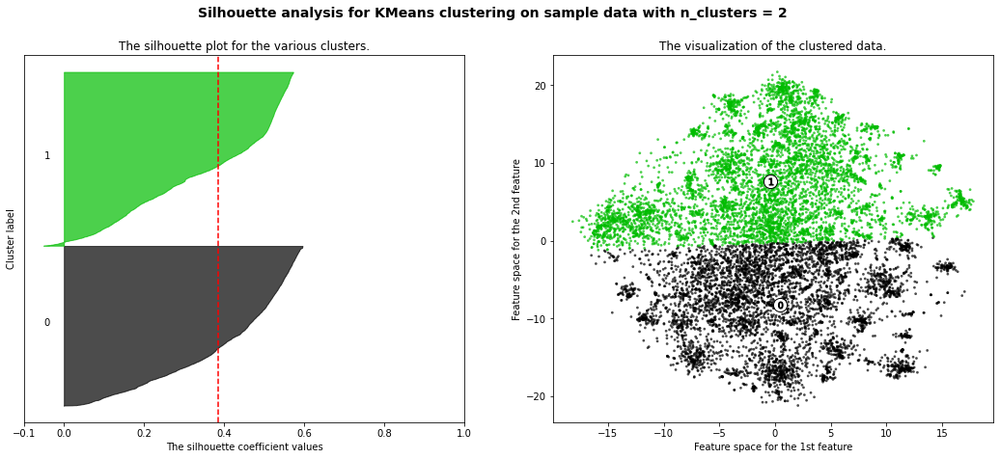

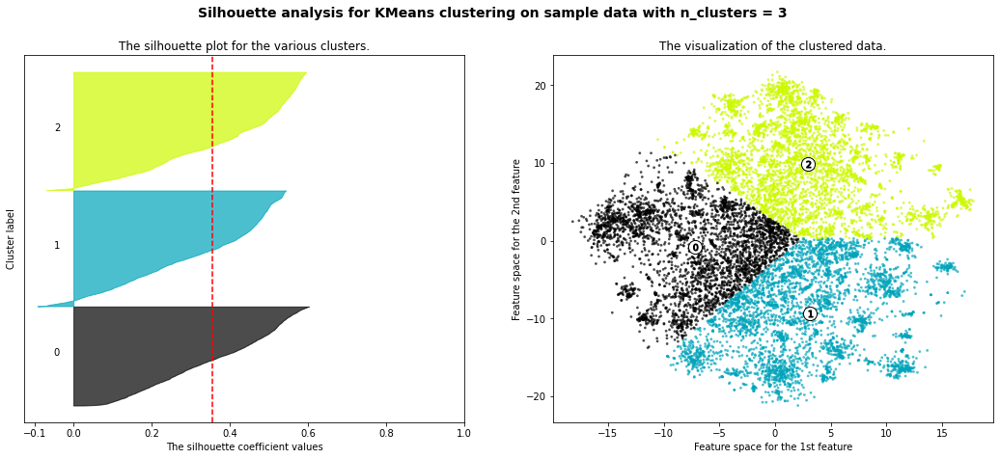

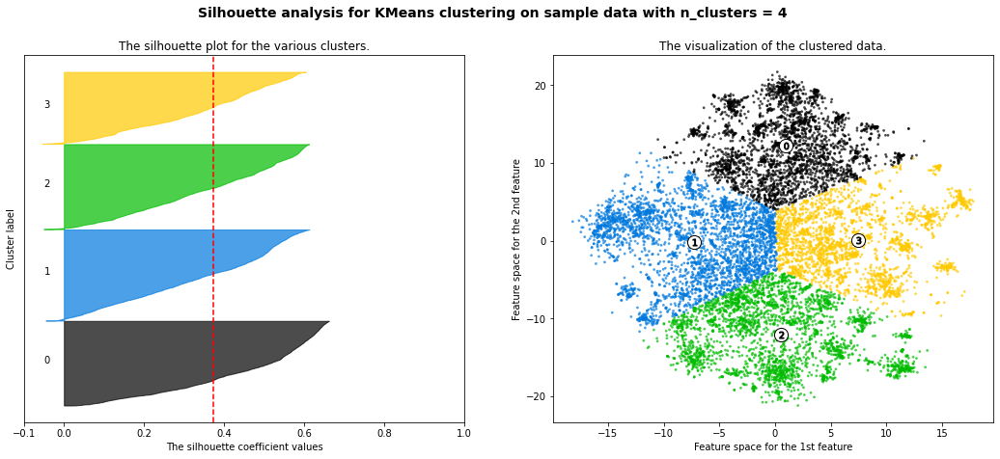

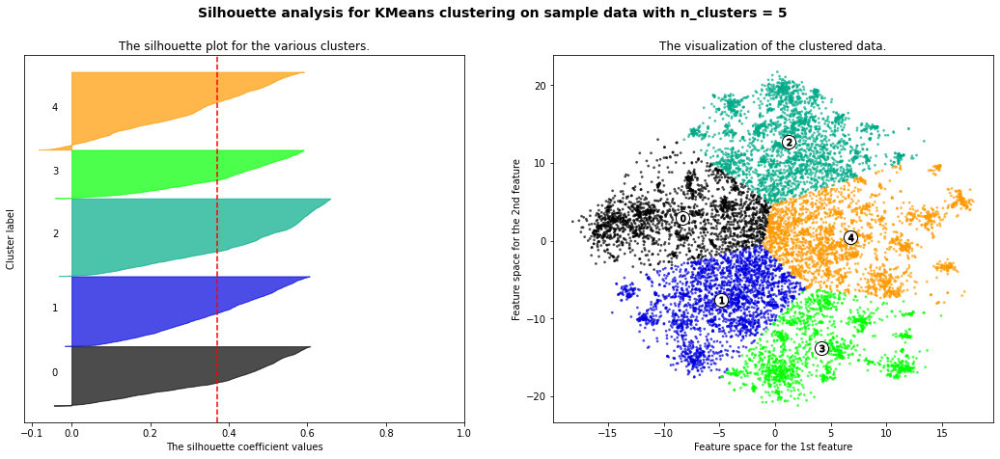

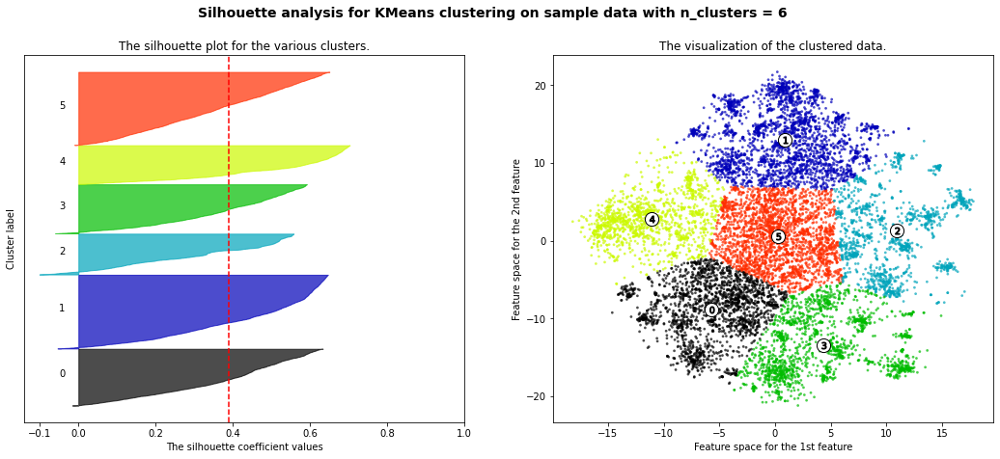

...

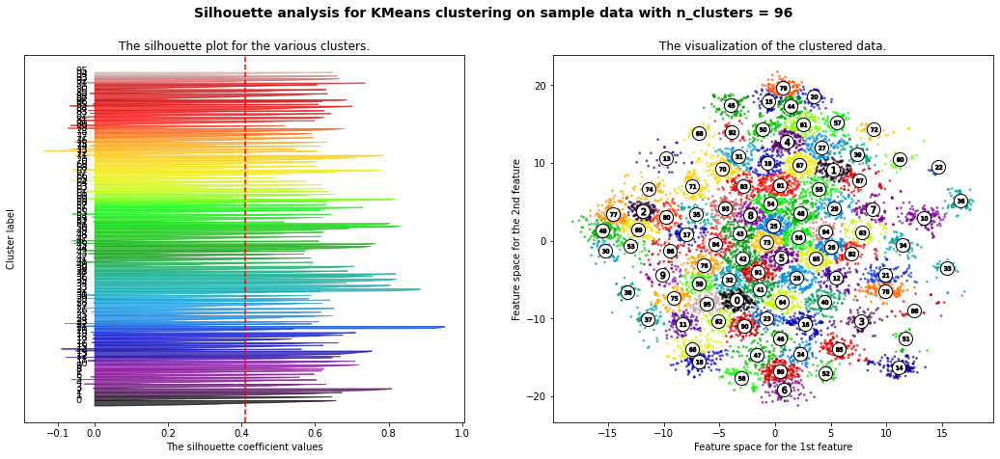

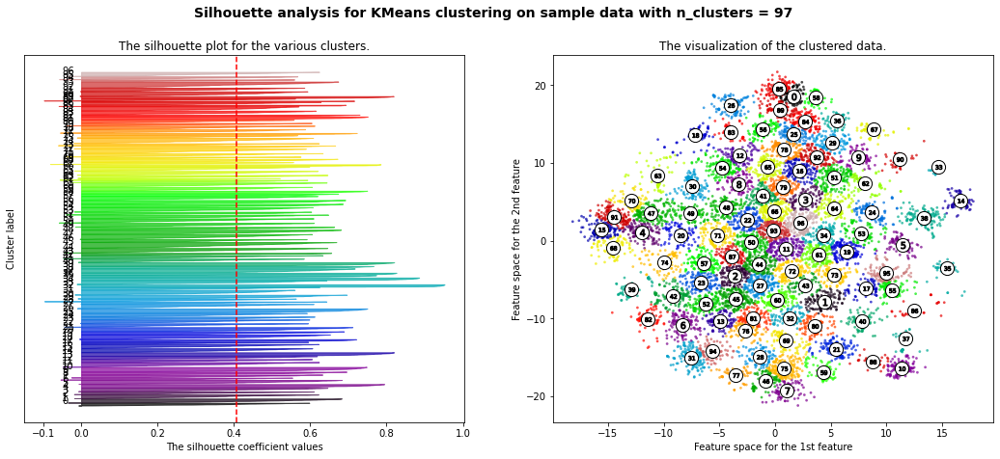

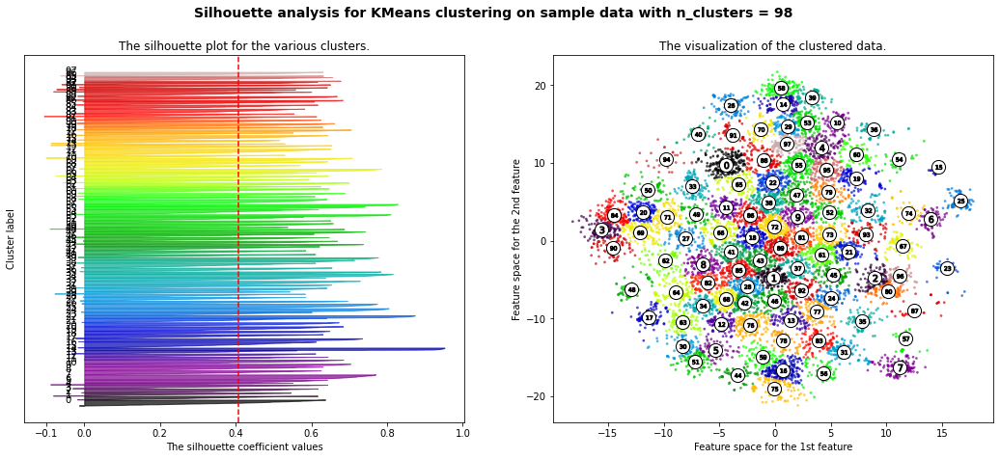

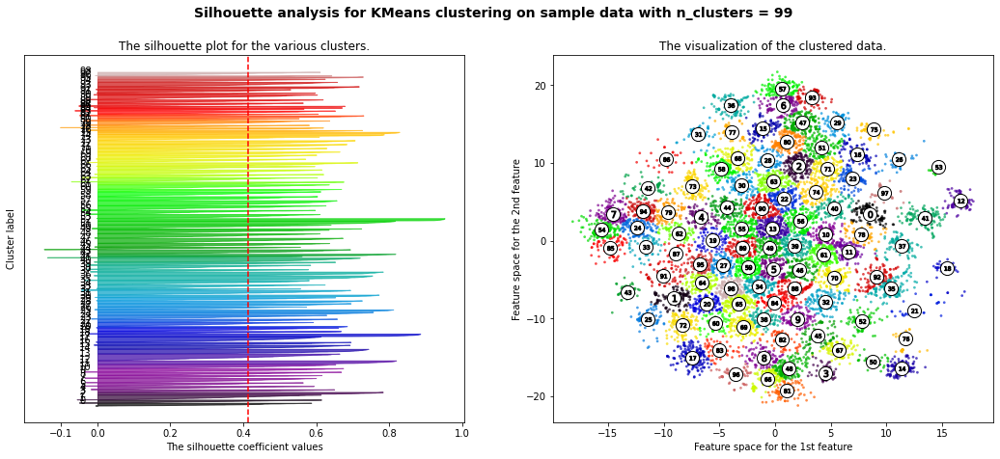

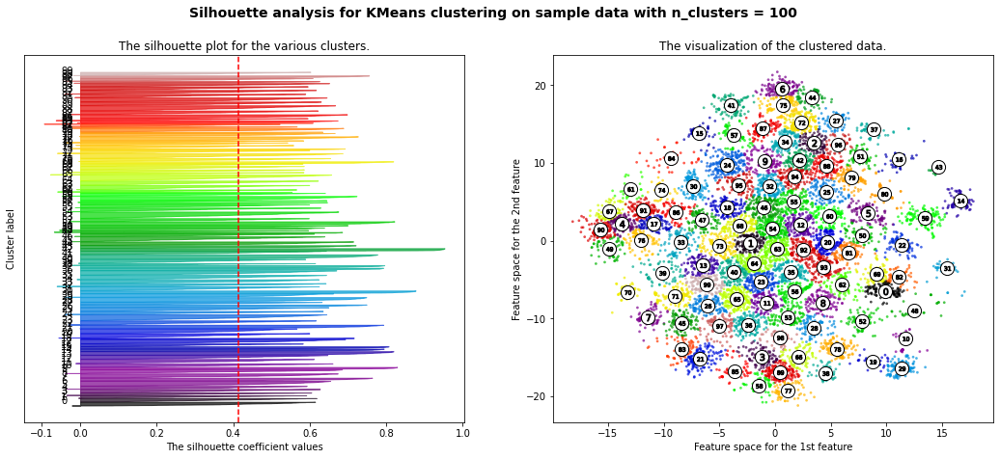

In [19]:
# wcss = []

for i in range(2, 101):

    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    # ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    # ax1.set_ylim([0, len(to_plot_tsne) + (i + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=i, random_state=10)
    cluster_labels = clusterer.fit_predict(to_plot_tsne)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(to_plot_tsne, cluster_labels)
    print(
        "For n_clusters =",
        i,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(to_plot_tsne, cluster_labels)

    y_lower = 10
    for j in range(i):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        jth_cluster_silhouette_values = sample_silhouette_values[cluster_labels == j]

        jth_cluster_silhouette_values.sort()

        size_cluster_j = jth_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_j

        color = cm.nipy_spectral(float(j) / i)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            jth_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_j, str(j))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / i)
    ax2.scatter(
        to_plot_tsne['x'], to_plot_tsne['y'], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for k, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % k, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % i,
        fontsize=14,
        fontweight="bold",
    )

plt.show()
#     clustering = KMeans(n_clusters=i, random_state=200)
#     clustering.fit(to_plot_tsne)
#     wcss.append(clustering.inertia_)

# ks = list(range(1,11))

# sns.lineplot(x = ks, y = wcss);

The somewhat extreme dimension reduction and using tSNE means that trying to get meaningful clusters out of this is somewhat difficult task. Suggestion is to go back and do silhouette analysis on the tfidf matrices to determine clusters. 

Eyeballing/back of the envelope/realistic effort investment suggest that using 6 as determined by elbow method is probably fine.